In [20]:
# # This Python 3 environment comes with many helpful analytics libraries installed
# # It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# # For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk(r'D:\Real Estate\House_Style_Project\House_style_ML\dataset'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# # You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# # You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [21]:
import numpy as np  # Linear algebra
import pandas as pd  # Data processing, CSV file I/O (e.g. pd.read_csv)
import os

# Use a relative path to the dataset directory
dataset_dir = os.path.join(os.getcwd(), 'dataset')

# Walk through the dataset directory
for dirname, _, filenames in os.walk(dataset_dir):
    for filename in filenames:
        print(os.path.join(dirname, filename))


d:\Real Estate\H_Classification_Recommendation\House_style_ML\dataset\ML-AR-Chicago School\078f8f88971426ae729d919ce11e6942.jpg
d:\Real Estate\H_Classification_Recommendation\House_style_ML\dataset\ML-AR-Chicago School\0df505fa53491a9ac49ba2f00de22f2d.jpg
d:\Real Estate\H_Classification_Recommendation\House_style_ML\dataset\ML-AR-Chicago School\1d66809eff05a23dab38d79ec34777fc.jpg
d:\Real Estate\H_Classification_Recommendation\House_style_ML\dataset\ML-AR-Chicago School\20c478f272d5d14015eab8170563a454.jpg
d:\Real Estate\H_Classification_Recommendation\House_style_ML\dataset\ML-AR-Chicago School\3b6b2134568dd116206bf7ff59e7c1bd.jpg
d:\Real Estate\H_Classification_Recommendation\House_style_ML\dataset\ML-AR-Chicago School\4013de6cc22838cd0ab14fd242ecbd84.jpg
d:\Real Estate\H_Classification_Recommendation\House_style_ML\dataset\ML-AR-Chicago School\53b07aa2b907885a963ba95ee2ae1aa7.jpg
d:\Real Estate\H_Classification_Recommendation\House_style_ML\dataset\ML-AR-Chicago School\57a48b2cf75ca

In [22]:
# !pip install python_splitter

In [23]:
import python_splitter
# If you want to create only Train-Test Folder(not Validation Folder)
# python_splitter.split_from_folder("D:\Real Estate\House_Style_Project\House_style_ML\dataset", train = 0.7, test = 0.3)
python_splitter.split_from_folder(os.path.join(os.getcwd(), 'dataset'), train=0.7, test=0.3)

✅Checking SOURCE directory...
0.7 0 0.3
✅Checking percentage validation...
✅Making required directories...
✅Shuffling data...
✅Getting ready for copying files...

-------------Successfully splitted !!!--------------- 


In [24]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
from tensorflow.keras.applications import MobileNet
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

## Splitted Data

In [25]:
target_img_shape = (224,224)
# train_dir = r'D:\Real Estate\House_Style_Project\House_style_ML\Train_Test_Folder\train'
# val_dir = r'D:\Real Estate\House_Style_Project\House_style_ML\Train_Test_Folder\test'

train_dir = os.path.join(os.path.join(os.getcwd(), 'Train_Test_Folder'), 'train')
val_dir = os.path.join(os.path.join(os.getcwd(), 'Train_Test_Folder'), 'test')

In [26]:
# train_datagen = ImageDataGenerator(preprocessing_function = preprocess_input)
# train_set = train_datagen.flow_from_directory(train_dir, target_size = target_img_shape, batch_size = 32, class_mode = 'sparse')

# Augmenting training data with transformations
train_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input,
    rotation_range=0,      # Randomly rotate images by 20 degrees
    width_shift_range=0.1,  # Randomly shift images horizontally (15% of the width)
    height_shift_range=0.1, # Randomly shift images vertically (15% of the height)
    shear_range=0.9,       # Randomly apply shearing
    zoom_range=0.7,        # Randomly zoom inside pictures
    horizontal_flip=True,   # Randomly flip images horizontally
    fill_mode='nearest'     # Fill pixels when the image is rotated or shifted
)

train_set = train_datagen.flow_from_directory(
    train_dir, 
    target_size=target_img_shape, 
    batch_size=32, 
    class_mode='sparse'
)

val_datagen = ImageDataGenerator(preprocessing_function = preprocess_input)
val_set = val_datagen.flow_from_directory(val_dir, target_size = target_img_shape, batch_size = 32, class_mode = 'sparse')

Found 286 images belonging to 13 classes.
Found 129 images belonging to 13 classes.


{'ML-AR-COLONIAL': 0, 'ML-AR-Chicago School': 1, 'ML-AR-Classic': 2, 'ML-AR-MEDITERRANEAN': 3, 'ML-AR-MID CENTURY': 4, 'ML-AR-Modern': 5, 'ML-AR-Modern Minimal': 6, 'ML-AR-Oriental': 7, 'ML-AR-SCANDINAVIAN': 8, 'ML-AR-THAI': 9, 'ML-AR-TRANSITIONAL': 10, 'ML-AR-TUDOR HOUSE': 11, 'ML-AR-VICTORIAN': 12}
(32, 224, 224, 3)
(32,)
class 11.0


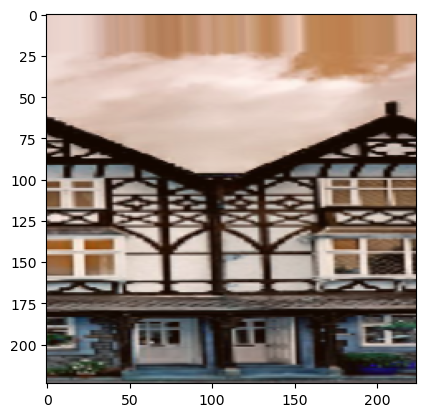

In [27]:
print(train_set.class_indices)
for image_batch, labels_batch in train_set:
    print(image_batch.shape)
    print(labels_batch.shape)

    img = image_batch[0] - image_batch[0].min()
    img /= 275.0
    plt.imshow(img)
    print('class', labels_batch[0])
    break

In [28]:
ids, counts = np.unique(train_set.classes, return_counts = True)
print(ids)
print(counts)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12]
[20 20 20 20 26 11 20 20 20 37 20 32 20]


In [29]:
labels = (train_set.class_indices)
labels = dict((v,k) for k,v in labels.items())
labels

for i in ids:
    print('{:>8} = {}'.format(labels[i], counts[i]))

ML-AR-COLONIAL = 20
ML-AR-Chicago School = 20
ML-AR-Classic = 20
ML-AR-MEDITERRANEAN = 20
ML-AR-MID CENTURY = 26
ML-AR-Modern = 11
ML-AR-Modern Minimal = 20
ML-AR-Oriental = 20
ML-AR-SCANDINAVIAN = 20
ML-AR-THAI = 37
ML-AR-TRANSITIONAL = 20
ML-AR-TUDOR HOUSE = 32
ML-AR-VICTORIAN = 20


In [30]:
ids, counts = np.unique(val_set.classes, return_counts = True)
print(ids)
print(counts)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12]
[ 9  9  9  9 12  5  9  9  9 17  9 14  9]


In [31]:
_, train_count = np.unique(train_set.classes, return_counts = True)
_, val_count = np.unique(val_set.classes, return_counts = True)

print('Ratio Validation/Training set:', val_count/train_count * 100)

Ratio Validation/Training set: [45.         45.         45.         45.         46.15384615 45.45454545
 45.         45.         45.         45.94594595 45.         43.75
 45.        ]


In [32]:
in_shape = (target_img_shape[0], target_img_shape[1], 3)
in_shape

(224, 224, 3)

In [33]:
# from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Dense, Dropout, Flatten, GlobalAveragePooling2D
base_model = ResNet50(include_top=False,
                      weights='imagenet',
                      input_shape=in_shape)

model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())  # Replacing Flatten with GAP to reduce overfitting
model.add(Dense(250, activation='relu'))
model.add(Dropout(0.4))  # Dropout to reduce overfitting
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.4))  # Dropout to reduce overfitting
# model.add(Dense(8, activation='relu'))
# model.add(Dropout(0.5))
model.add(Dense(13, activation='softmax'))  # Output layer for 13 classes
base_model.trainable = False
# base_model.trainable = True
model.summary()


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, 7, 7, 2048)     │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 250)            │       512,250 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 250)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 128)            │        32,128 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 13)             │         1,677 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 24,133,767 (92.06 MB)

 Trainable params: 546,055 (2.08 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [34]:
# from tensorflow.keras.applications import ResNet50
# from tensorflow.keras.models import Model
# from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
# from tensorflow.keras.optimizers import Adam

# # Load the ResNet50 model pre-trained on ImageNet
# base_model = ResNet50(include_top=False, weights='imagenet', input_shape=in_shape)

# # Adding the classification head
# x = base_model.output
# x = GlobalAveragePooling2D()(x)  # Global average pooling layer
# output_layer = Dense(13, activation='softmax')(x)  # Output layer for 13 classes

# # Creating the final model
# model = Model(inputs=base_model.input, outputs=output_layer)

# # Optionally, you can freeze the base model layers during initial training
# base_model.trainable = False

# # Compile the model
# # model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

# model.summary()

In [35]:
# base_model.trainable = False

In [36]:
print("Trainable..\n---")
for variable in model.trainable_variables:
    print(variable.name)

Trainable..
---
kernel
bias
kernel
bias
kernel
bias


In [37]:
# resnet.summary()

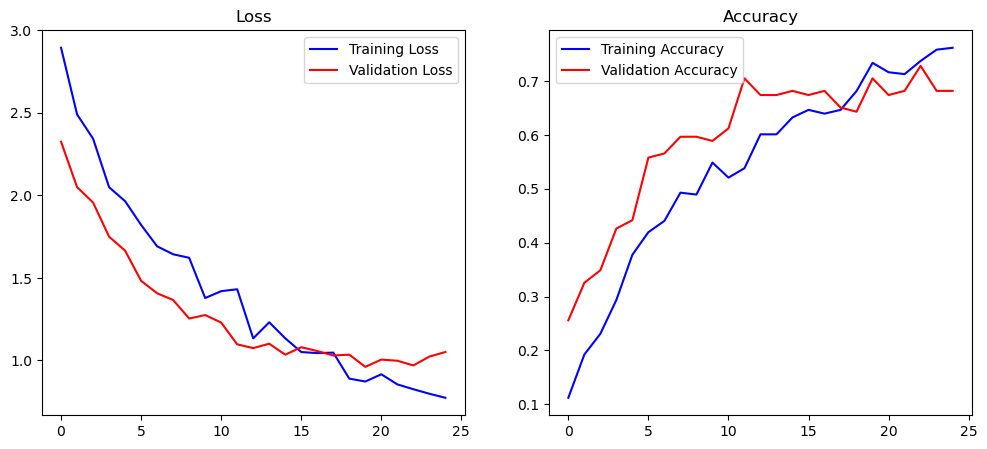

9/9 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.7579 - loss: 0.7502 - val_accuracy: 0.6822 - val_loss: 1.0512
Epoch 25: early stopping
Restoring model weights from the end of the best epoch: 20.
Time Taken: 7.66 minutes


In [38]:
import time
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback
from IPython.display import clear_output, display

# Model Compilation
model.compile(optimizer=Adam(learning_rate=0.001), 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])

# Callbacks
es = EarlyStopping(monitor='val_loss', verbose=1, patience=5, restore_best_weights=True)
mc = ModelCheckpoint('best_model13cls.keras', monitor='val_accuracy', verbose=1, save_best_only=True)

# Custom Callback for Real-Time Plotting with IPython.display
class RealTimePlot(Callback):
    def on_train_begin(self, logs=None):
        self.epochs = []
        self.losses = []
        self.val_losses = []
        self.accuracies = []
        self.val_accuracies = []

    def on_epoch_end(self, epoch, logs=None):
        self.epochs.append(epoch)
        self.losses.append(logs['loss'])
        self.val_losses.append(logs['val_loss'])
        self.accuracies.append(logs['accuracy'])
        self.val_accuracies.append(logs['val_accuracy'])

        # Clear the output and plot the updated data
        clear_output(wait=True)
        plt.figure(figsize=(12, 5))

        # Plotting the losses
        plt.subplot(1, 2, 1)
        plt.plot(self.epochs, self.losses, label='Training Loss', color='b')
        plt.plot(self.epochs, self.val_losses, label='Validation Loss', color='r')
        plt.title("Loss")
        plt.legend()

        # Plotting the accuracies
        plt.subplot(1, 2, 2)
        plt.plot(self.epochs, self.accuracies, label='Training Accuracy', color='b')
        plt.plot(self.epochs, self.val_accuracies, label='Validation Accuracy', color='r')
        plt.title("Accuracy")
        plt.legend()

        plt.show()

# Instantiate the custom callback
real_time_plot = RealTimePlot()

# Training the model with the custom callback
start = time.time()
history = model.fit(train_set,
                    validation_data=val_set,
                    epochs=100, 
                    verbose=1, 
                    callbacks=[es, mc, real_time_plot])
end = time.time()

print("Time Taken: {:.2f} minutes".format((end - start)/60))


In [39]:
acc = model.evaluate(val_set, steps=len(val_set), verbose=1)
print('score = {:.3f}'.format(acc[1]))

5/5 ━━━━━━━━━━━━━━━━━━━━ 5s 860ms/step - accuracy: 0.7052 - loss: 0.9866
score = 0.705


In [40]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
def predict(img_fname):
    # Load and preprocess the image
    img = load_img(img_fname, target_size=target_img_shape)  # Adjust target_img_shape as per your model's input
    plt.figure()  # Open a new figure for each image
    plt.imshow(img)
    plt.axis('off')  # Turn off axes for better viewing
    plt.title(os.path.basename(os.path.dirname(img_fname)))
    plt.show()

    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = preprocess_input(img)
    
    # Make prediction
    pred = model.predict(img)
    pred_probabilities = pred[0]

    # Get the top 3 predictions
    top_indices = pred_probabilities.argsort()[-3:][::-1]  # Indices of top 3 predictions
    top_labels = [(list(labels.values())[i], pred_probabilities[i]) for i in top_indices]  # Assuming `labels` is a dictionary or list

    # Display the top 3 predictions with their probabilities
    print("Top 3 Predictions:")
    for label, probability in top_labels:
        print(f"{label} : {round(probability * 100, 2):.2f}%")

    # Extracting the actual class from the file path
    actual_cls = os.path.basename(os.path.dirname(img_fname))  # Assumes the image file is within a folder named by its class
    print('Actual Class:', actual_cls)
    
    # Get the predicted class (highest probability)
    pred_cls = list(labels.values())[np.argmax(pred, -1)[0]]
    print('Prediction:', pred_cls)


In [41]:
labels

{0: 'ML-AR-COLONIAL',
 1: 'ML-AR-Chicago School',
 2: 'ML-AR-Classic',
 3: 'ML-AR-MEDITERRANEAN',
 4: 'ML-AR-MID CENTURY',
 5: 'ML-AR-Modern',
 6: 'ML-AR-Modern Minimal',
 7: 'ML-AR-Oriental',
 8: 'ML-AR-SCANDINAVIAN',
 9: 'ML-AR-THAI',
 10: 'ML-AR-TRANSITIONAL',
 11: 'ML-AR-TUDOR HOUSE',
 12: 'ML-AR-VICTORIAN'}

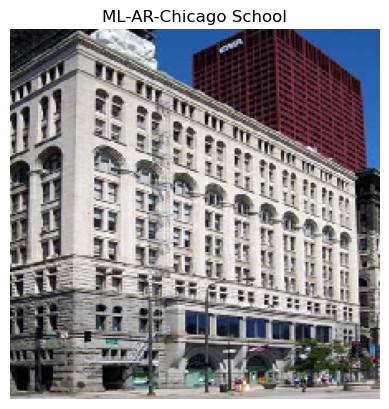

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Top 3 Predictions:
ML-AR-Chicago School : 99.72%
ML-AR-Classic : 0.24%
ML-AR-COLONIAL : 0.02%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


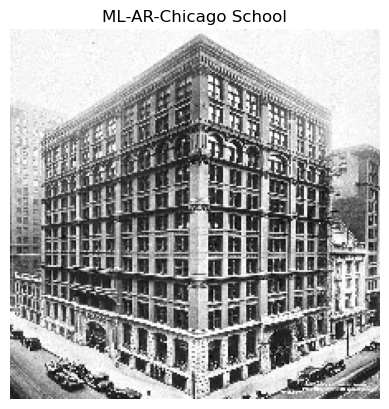

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Classic : 0.00%
ML-AR-COLONIAL : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


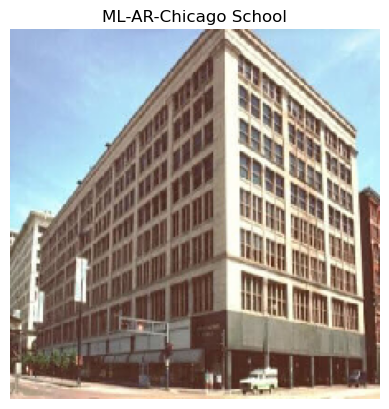

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Classic : 0.00%
ML-AR-COLONIAL : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


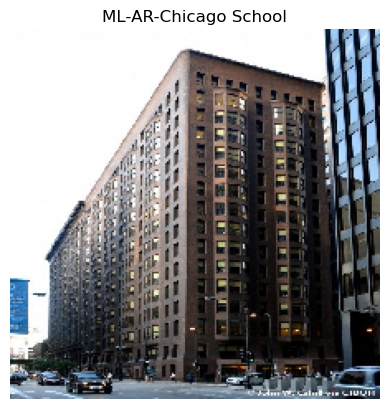

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Classic : 0.00%
ML-AR-COLONIAL : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


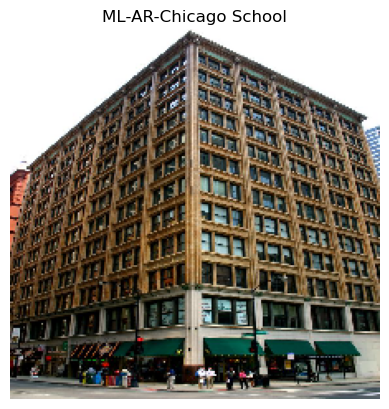

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Classic : 0.00%
ML-AR-TUDOR HOUSE : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


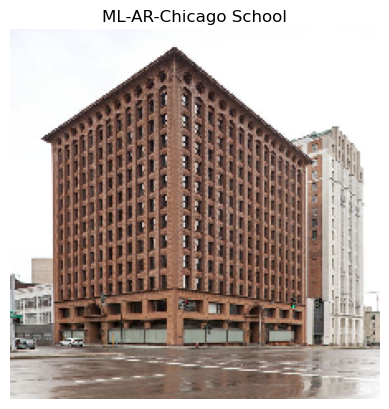

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Classic : 0.00%
ML-AR-COLONIAL : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


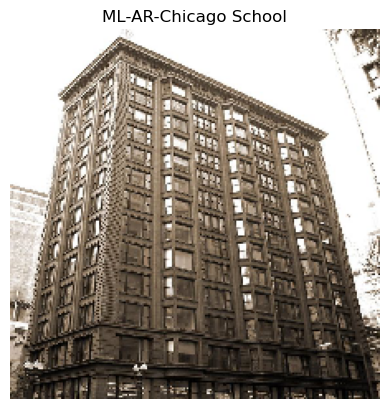

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Classic : 0.00%
ML-AR-TUDOR HOUSE : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


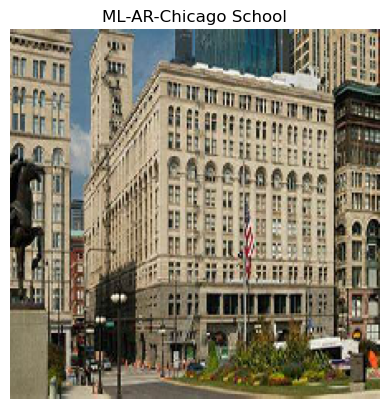

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Top 3 Predictions:
ML-AR-Chicago School : 97.53%
ML-AR-Classic : 1.78%
ML-AR-COLONIAL : 0.36%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


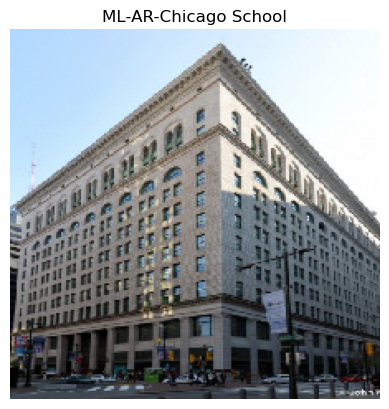

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Top 3 Predictions:
ML-AR-Chicago School : 99.77%
ML-AR-Classic : 0.20%
ML-AR-COLONIAL : 0.01%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


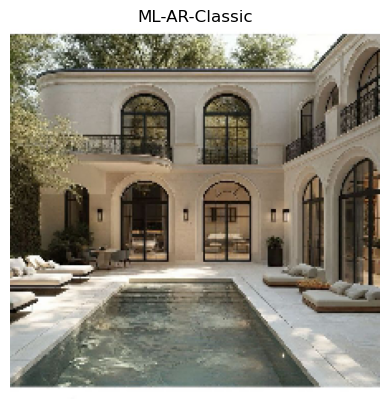

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
Top 3 Predictions:
ML-AR-Classic : 95.78%
ML-AR-COLONIAL : 1.62%
ML-AR-MEDITERRANEAN : 1.16%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


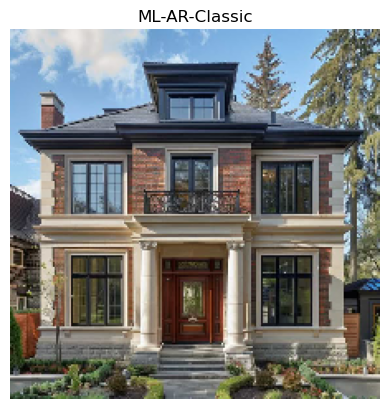

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 28.67%
ML-AR-Classic : 23.98%
ML-AR-VICTORIAN : 20.54%
Actual Class: ML-AR-Classic
Prediction: ML-AR-COLONIAL


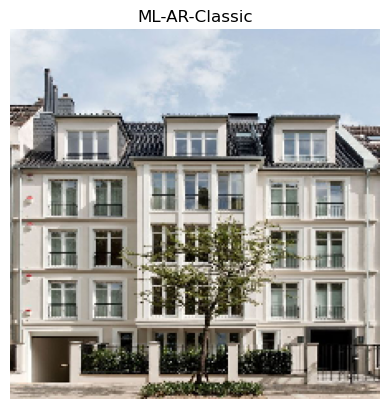

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 52.70%
ML-AR-Classic : 24.80%
ML-AR-COLONIAL : 17.26%
Actual Class: ML-AR-Classic
Prediction: ML-AR-VICTORIAN


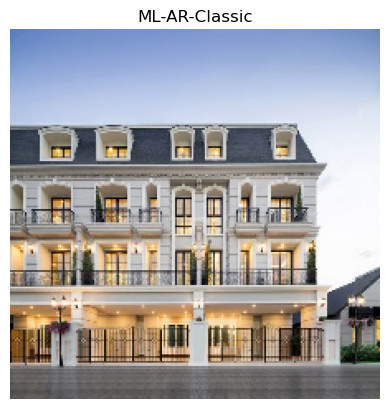

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 96ms/step
Top 3 Predictions:
ML-AR-Classic : 44.28%
ML-AR-VICTORIAN : 32.14%
ML-AR-COLONIAL : 16.98%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


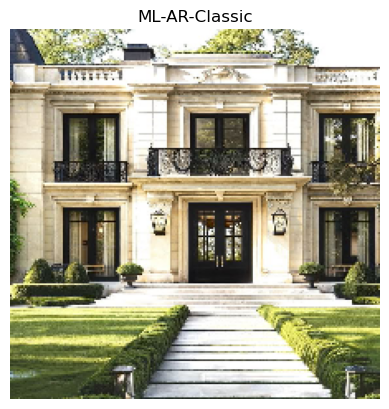

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 40.49%
ML-AR-Classic : 27.89%
ML-AR-VICTORIAN : 25.26%
Actual Class: ML-AR-Classic
Prediction: ML-AR-COLONIAL


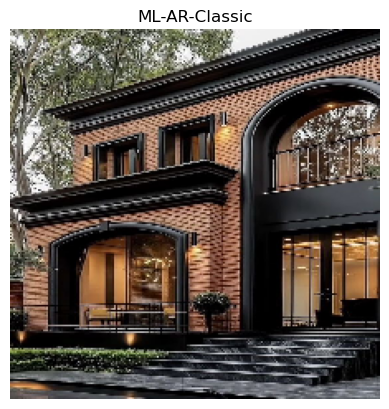

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
Top 3 Predictions:
ML-AR-Classic : 31.63%
ML-AR-MEDITERRANEAN : 24.04%
ML-AR-COLONIAL : 17.13%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


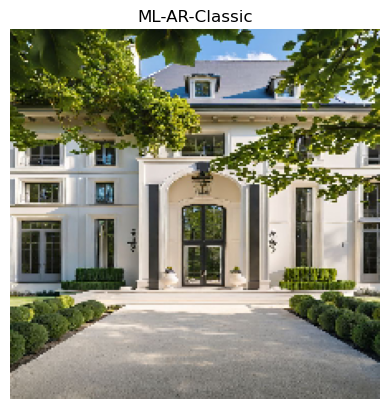

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
Top 3 Predictions:
ML-AR-Classic : 64.78%
ML-AR-MEDITERRANEAN : 11.25%
ML-AR-COLONIAL : 9.31%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


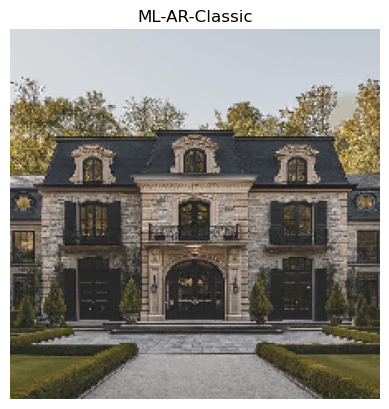

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
Top 3 Predictions:
ML-AR-Classic : 42.06%
ML-AR-TUDOR HOUSE : 25.03%
ML-AR-TRANSITIONAL : 17.16%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


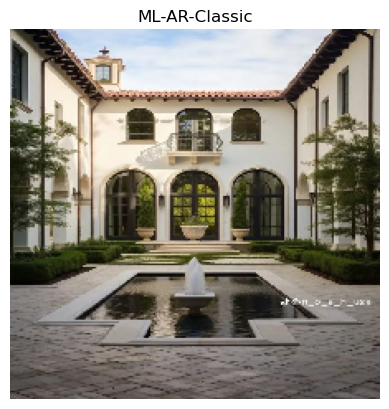

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 56.61%
ML-AR-COLONIAL : 21.04%
ML-AR-Classic : 18.88%
Actual Class: ML-AR-Classic
Prediction: ML-AR-MEDITERRANEAN


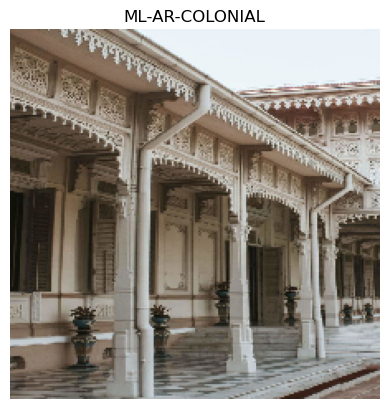

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 82.43%
ML-AR-VICTORIAN : 11.60%
ML-AR-Classic : 2.92%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


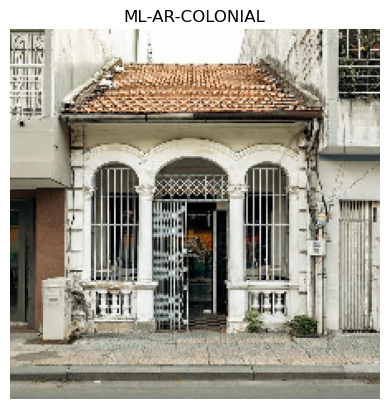

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 68.63%
ML-AR-VICTORIAN : 18.71%
ML-AR-MEDITERRANEAN : 6.71%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


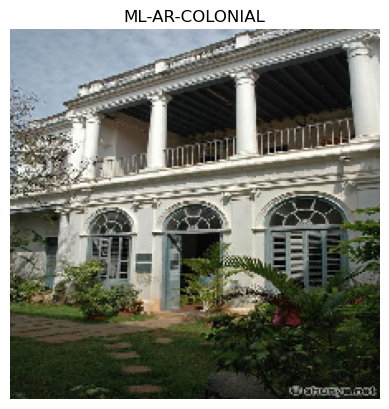

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 45.52%
ML-AR-COLONIAL : 24.46%
ML-AR-Classic : 23.40%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-VICTORIAN


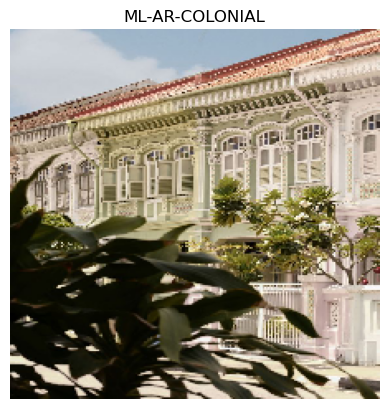

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 46.32%
ML-AR-Classic : 27.10%
ML-AR-VICTORIAN : 22.30%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


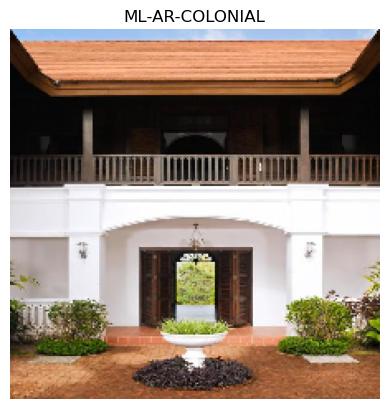

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Top 3 Predictions:
ML-AR-THAI : 46.33%
ML-AR-MEDITERRANEAN : 18.23%
ML-AR-Oriental : 12.26%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-THAI


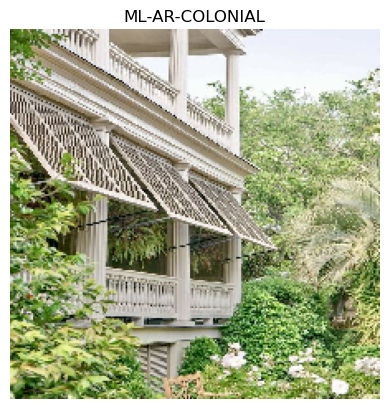

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
Top 3 Predictions:
ML-AR-THAI : 31.17%
ML-AR-TUDOR HOUSE : 25.64%
ML-AR-Oriental : 20.22%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-THAI


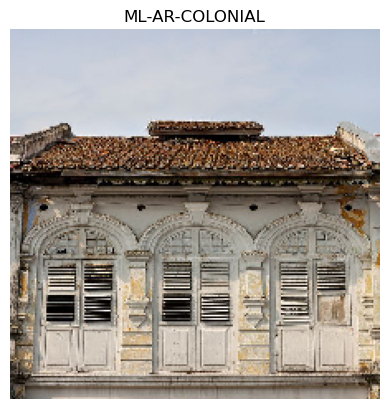

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 54.12%
ML-AR-COLONIAL : 35.75%
ML-AR-Classic : 6.79%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-VICTORIAN


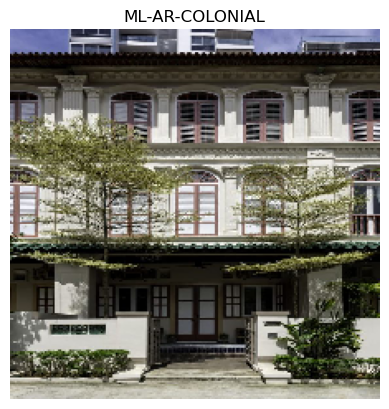

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 70.12%
ML-AR-COLONIAL : 15.81%
ML-AR-Classic : 11.24%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-VICTORIAN


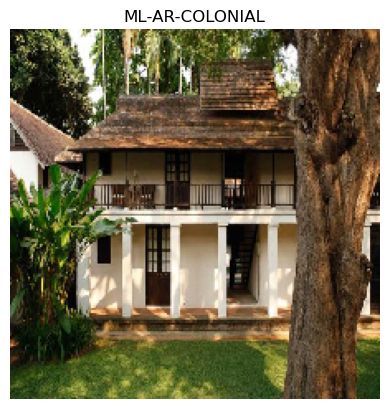

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
Top 3 Predictions:
ML-AR-THAI : 85.00%
ML-AR-Oriental : 9.05%
ML-AR-Modern : 2.72%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-THAI


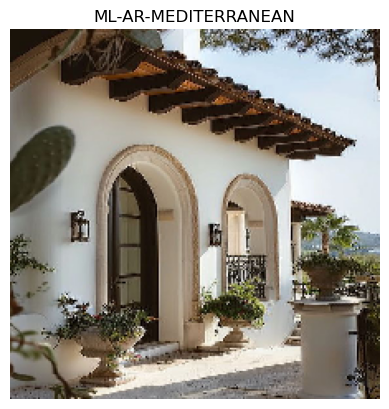

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 92.45%
ML-AR-COLONIAL : 6.18%
ML-AR-VICTORIAN : 0.43%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


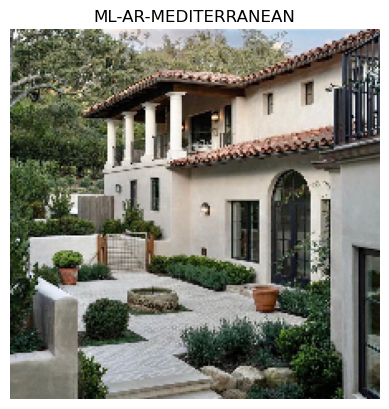

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 93.66%
ML-AR-COLONIAL : 1.88%
ML-AR-Oriental : 1.43%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


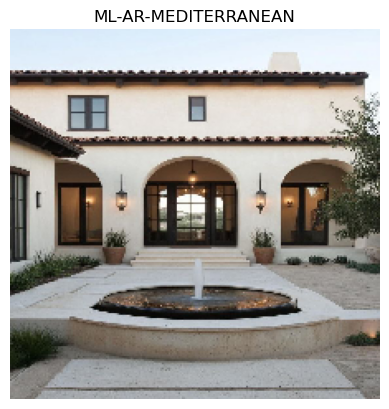

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 95.66%
ML-AR-COLONIAL : 1.86%
ML-AR-Classic : 1.10%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


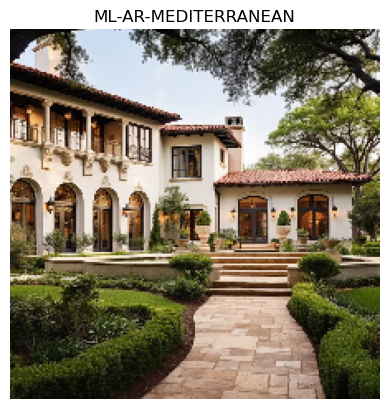

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 92.35%
ML-AR-COLONIAL : 5.06%
ML-AR-VICTORIAN : 0.79%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


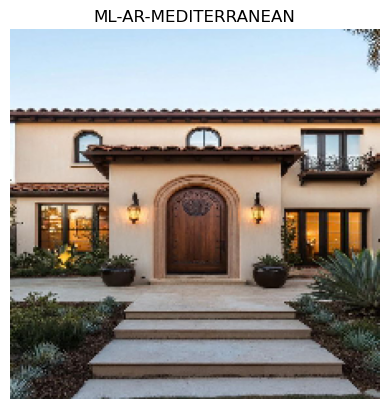

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 95.28%
ML-AR-COLONIAL : 3.76%
ML-AR-MID CENTURY : 0.60%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


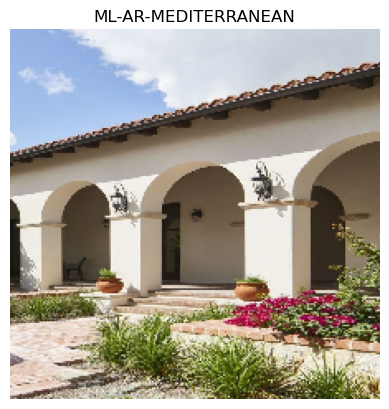

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 91.18%
ML-AR-COLONIAL : 4.63%
ML-AR-MID CENTURY : 1.49%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


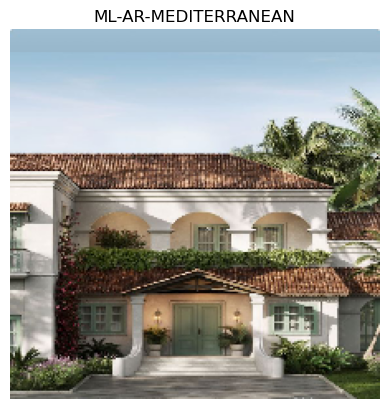

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 81.03%
ML-AR-COLONIAL : 13.69%
ML-AR-Oriental : 2.85%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


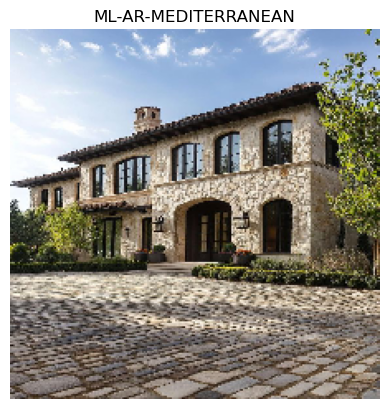

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 25.14%
ML-AR-COLONIAL : 24.67%
ML-AR-Classic : 18.24%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


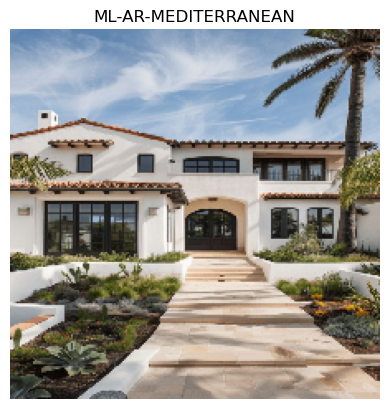

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 87.52%
ML-AR-COLONIAL : 7.42%
ML-AR-Classic : 2.48%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


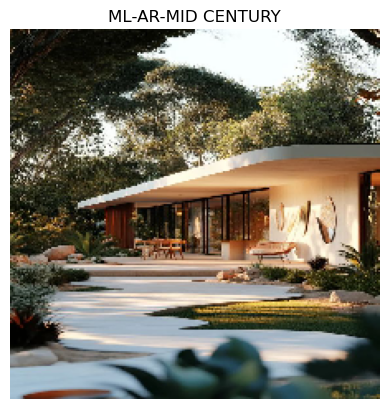

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 85.08%
ML-AR-MEDITERRANEAN : 7.52%
ML-AR-COLONIAL : 3.37%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


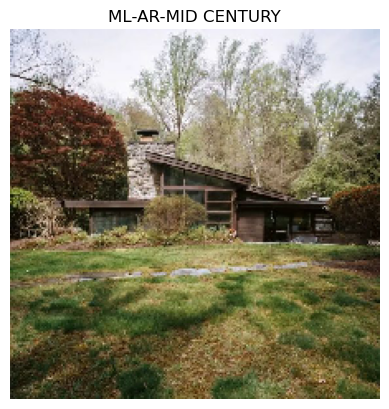

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 66.29%
ML-AR-Modern : 16.69%
ML-AR-Oriental : 5.64%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


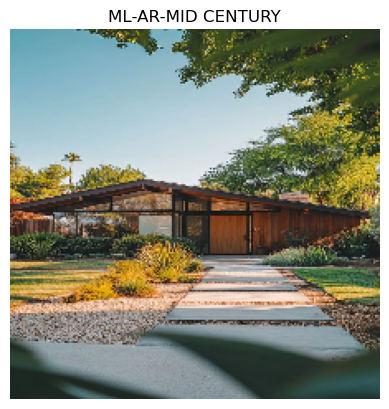

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.94%
ML-AR-Modern : 0.02%
ML-AR-MEDITERRANEAN : 0.01%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


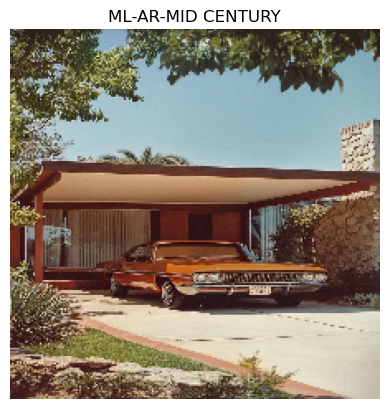

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 97.52%
ML-AR-MEDITERRANEAN : 1.46%
ML-AR-Modern : 0.63%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


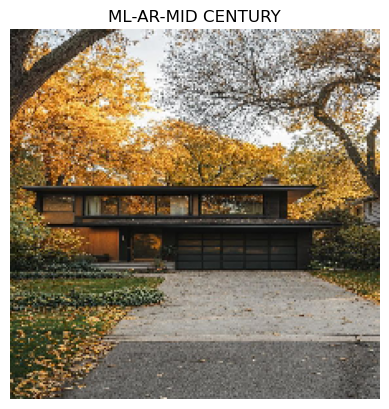

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.83%
ML-AR-Modern : 0.10%
ML-AR-Oriental : 0.01%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


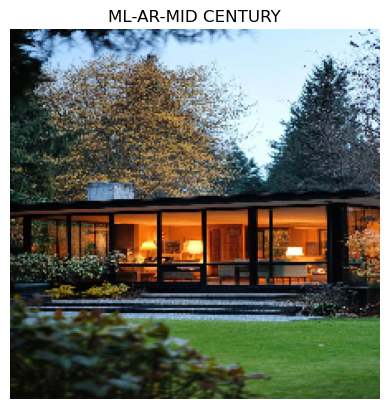

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.24%
ML-AR-Modern : 0.29%
ML-AR-MEDITERRANEAN : 0.18%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


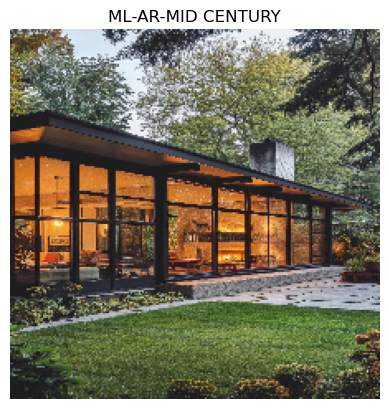

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.79%
ML-AR-Modern : 0.05%
ML-AR-TUDOR HOUSE : 0.05%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


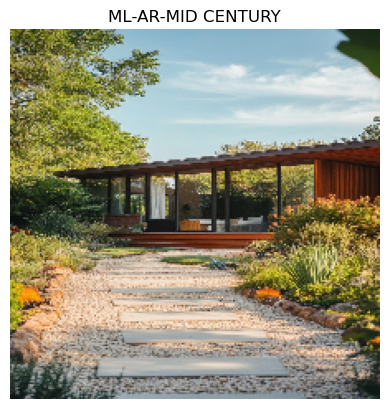

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.82%
ML-AR-Modern : 0.09%
ML-AR-MEDITERRANEAN : 0.04%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


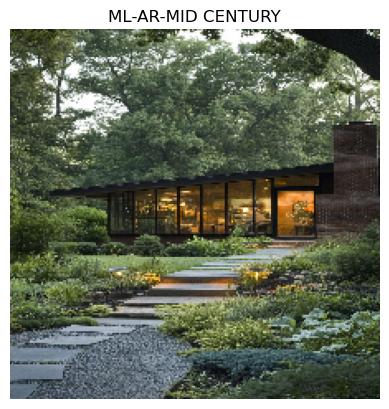

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.09%
ML-AR-Modern : 0.57%
ML-AR-THAI : 0.12%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


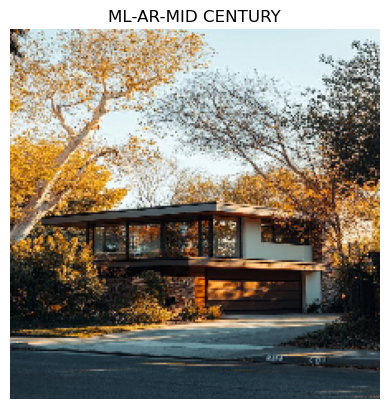

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 98.88%
ML-AR-Modern : 0.85%
ML-AR-MEDITERRANEAN : 0.07%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


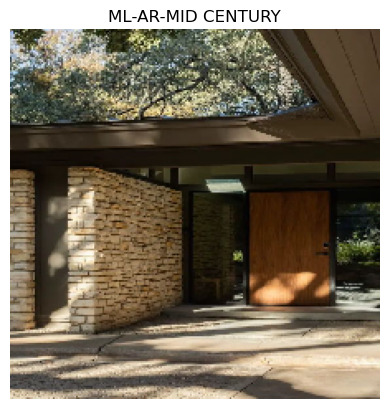

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 96.53%
ML-AR-THAI : 1.16%
ML-AR-Modern : 0.93%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


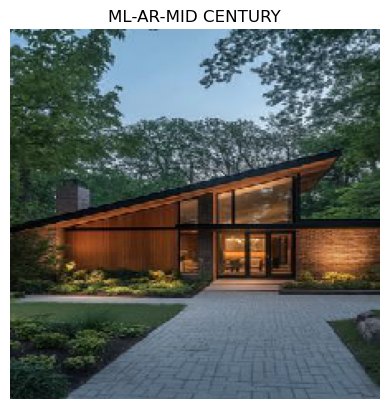

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 54.91%
ML-AR-Modern : 16.43%
ML-AR-SCANDINAVIAN : 11.00%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


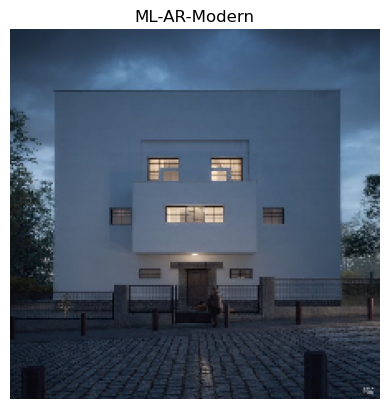

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 71.50%
ML-AR-Classic : 10.33%
ML-AR-Modern : 6.40%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Modern Minimal


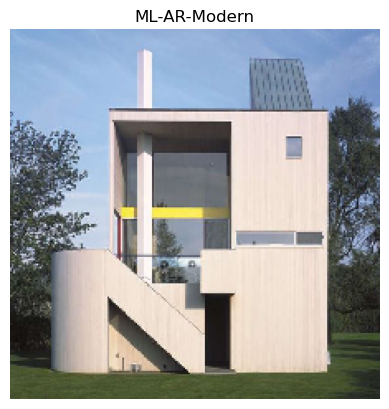

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 84.18%
ML-AR-Modern : 8.71%
ML-AR-SCANDINAVIAN : 6.44%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Modern Minimal


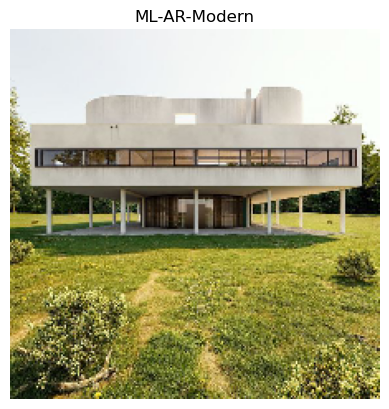

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Top 3 Predictions:
ML-AR-Modern : 48.84%
ML-AR-Modern Minimal : 28.92%
ML-AR-SCANDINAVIAN : 8.45%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Modern


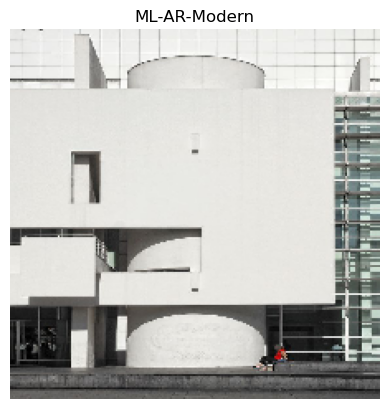

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 64.32%
ML-AR-Classic : 11.63%
ML-AR-Modern : 11.62%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Modern Minimal


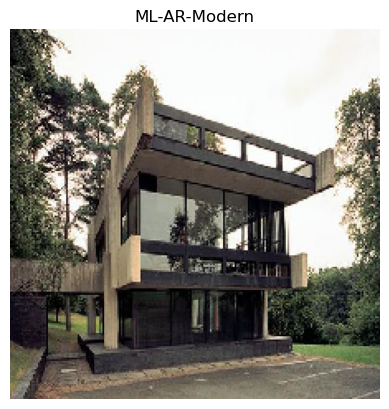

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
Top 3 Predictions:
ML-AR-Oriental : 37.26%
ML-AR-THAI : 27.60%
ML-AR-Modern : 14.70%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Oriental


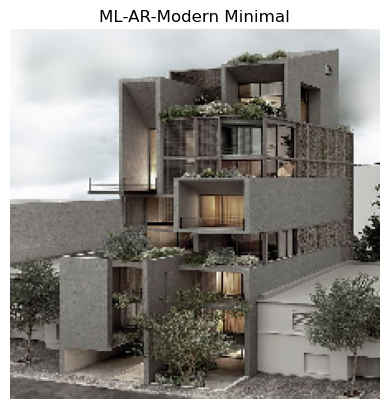

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 93.58%
ML-AR-Modern : 3.38%
ML-AR-Oriental : 1.17%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


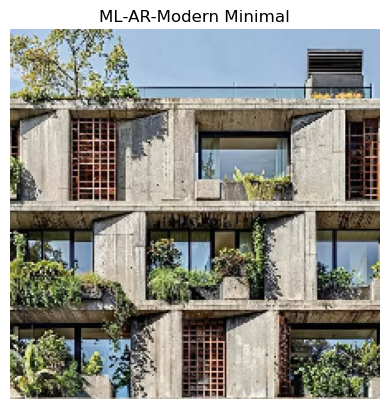

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 34.95%
ML-AR-Oriental : 24.74%
ML-AR-Modern : 8.79%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


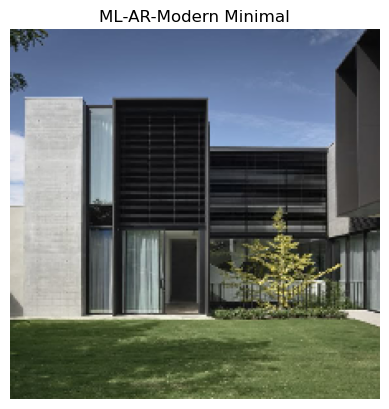

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 56.46%
ML-AR-SCANDINAVIAN : 27.38%
ML-AR-TRANSITIONAL : 6.40%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


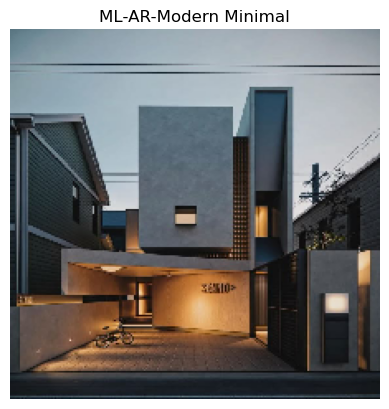

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 143ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 88.13%
ML-AR-SCANDINAVIAN : 3.62%
ML-AR-Oriental : 2.10%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


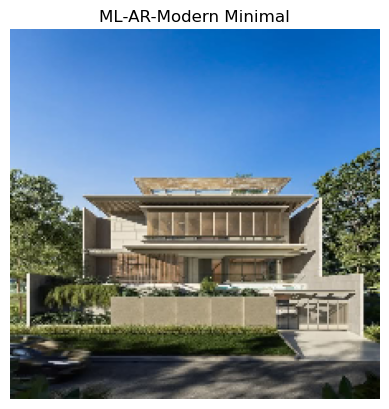

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
Top 3 Predictions:
ML-AR-Oriental : 38.24%
ML-AR-Modern Minimal : 18.63%
ML-AR-THAI : 13.83%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Oriental


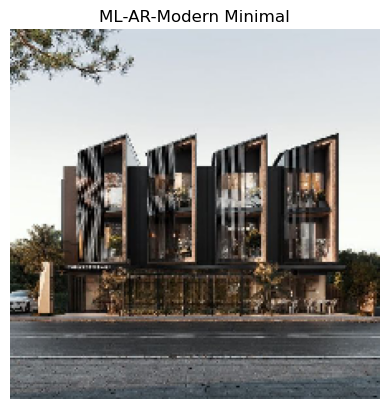

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 36.55%
ML-AR-Oriental : 18.91%
ML-AR-SCANDINAVIAN : 11.83%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


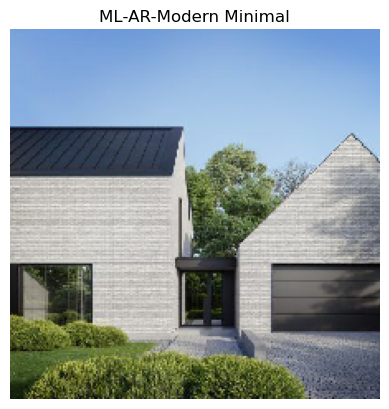

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 82.32%
ML-AR-Modern Minimal : 11.24%
ML-AR-TRANSITIONAL : 3.55%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-SCANDINAVIAN


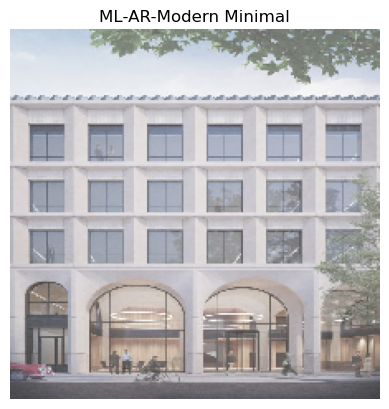

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
Top 3 Predictions:
ML-AR-Classic : 74.74%
ML-AR-COLONIAL : 8.65%
ML-AR-VICTORIAN : 8.19%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Classic


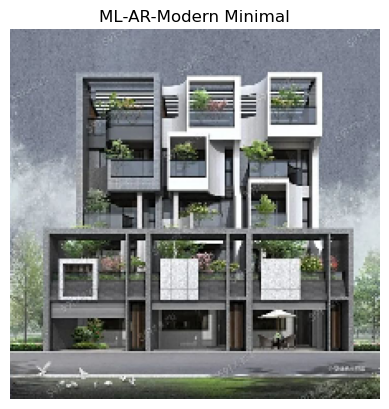

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 172ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 81.88%
ML-AR-Modern : 8.20%
ML-AR-Oriental : 4.55%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


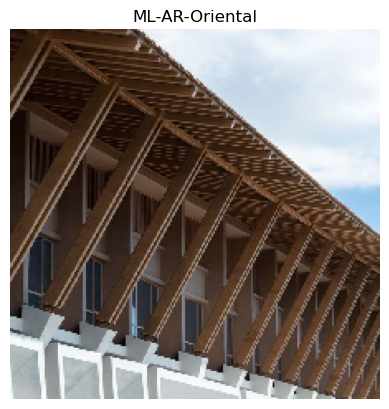

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
Top 3 Predictions:
ML-AR-Chicago School : 97.24%
ML-AR-THAI : 0.79%
ML-AR-COLONIAL : 0.55%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Chicago School


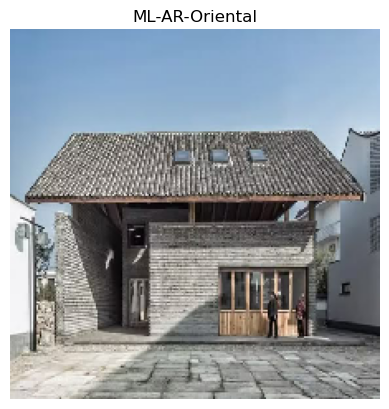

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
Top 3 Predictions:
ML-AR-THAI : 59.88%
ML-AR-SCANDINAVIAN : 16.10%
ML-AR-Oriental : 10.08%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-THAI


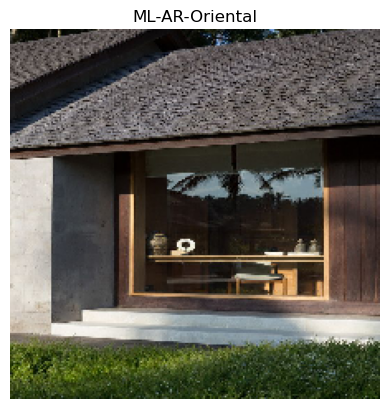

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step
Top 3 Predictions:
ML-AR-THAI : 77.51%
ML-AR-Oriental : 13.45%
ML-AR-MID CENTURY : 4.76%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-THAI


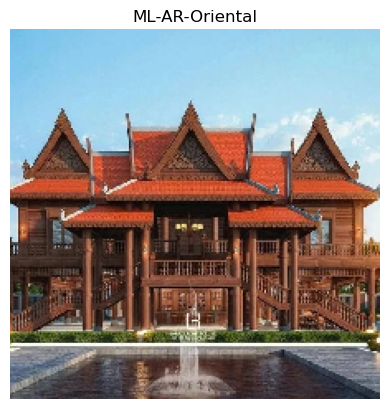

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
Top 3 Predictions:
ML-AR-THAI : 99.30%
ML-AR-Oriental : 0.57%
ML-AR-TUDOR HOUSE : 0.09%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-THAI


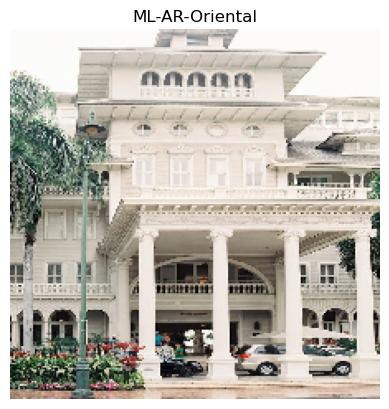

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 59.46%
ML-AR-VICTORIAN : 37.65%
ML-AR-Classic : 2.28%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-COLONIAL


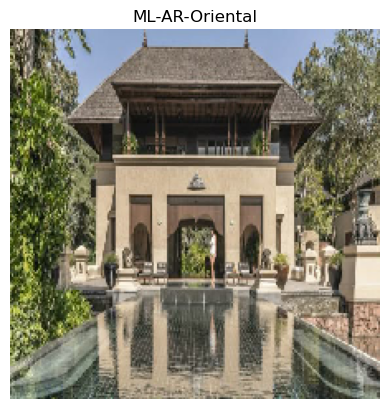

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 166ms/step
Top 3 Predictions:
ML-AR-Classic : 61.45%
ML-AR-Oriental : 12.52%
ML-AR-TRANSITIONAL : 7.16%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Classic


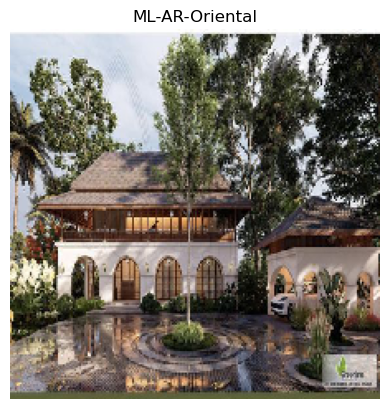

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
Top 3 Predictions:
ML-AR-THAI : 29.49%
ML-AR-Oriental : 24.58%
ML-AR-MEDITERRANEAN : 22.25%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-THAI


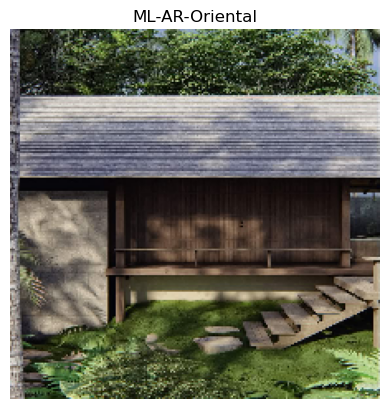

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
Top 3 Predictions:
ML-AR-Modern : 29.95%
ML-AR-MID CENTURY : 29.06%
ML-AR-Oriental : 18.44%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Modern


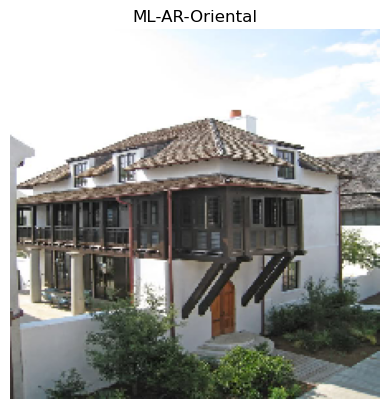

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 173ms/step
Top 3 Predictions:
ML-AR-Oriental : 34.69%
ML-AR-THAI : 23.31%
ML-AR-Modern Minimal : 8.43%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Oriental


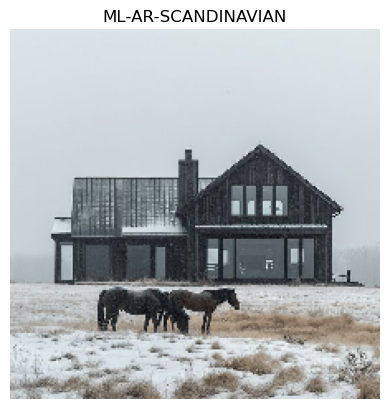

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 49.66%
ML-AR-THAI : 18.12%
ML-AR-Oriental : 15.28%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


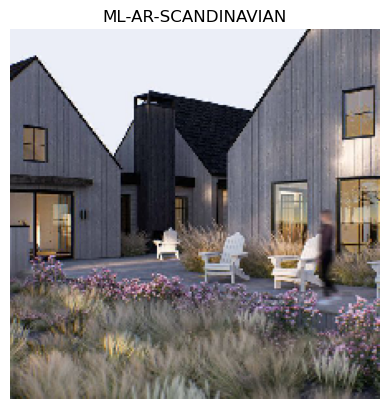

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 84.61%
ML-AR-TRANSITIONAL : 12.00%
ML-AR-Modern Minimal : 1.57%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


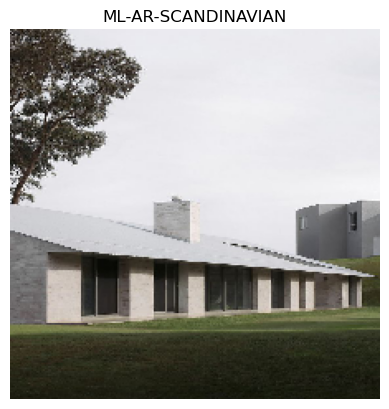

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 44.99%
ML-AR-SCANDINAVIAN : 40.57%
ML-AR-Modern : 8.08%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-Modern Minimal


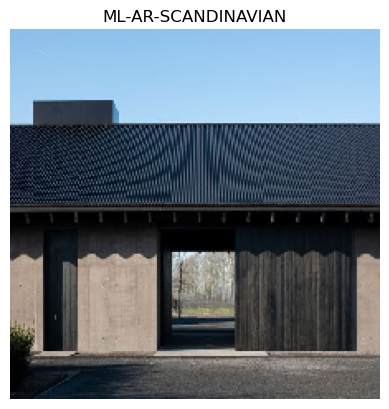

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 62.35%
ML-AR-Oriental : 15.99%
ML-AR-THAI : 9.06%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


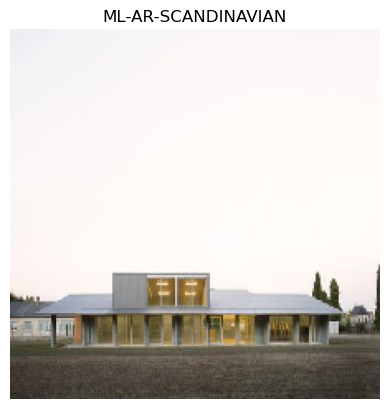

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 37.93%
ML-AR-SCANDINAVIAN : 18.30%
ML-AR-Oriental : 12.59%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-Modern Minimal


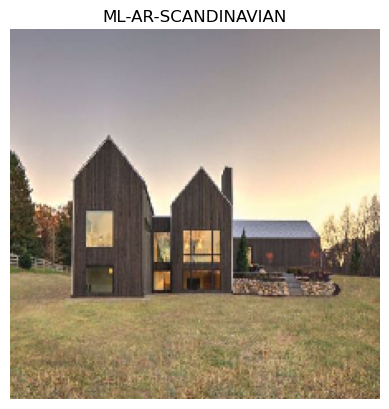

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 67.69%
ML-AR-TUDOR HOUSE : 9.40%
ML-AR-Modern Minimal : 5.70%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


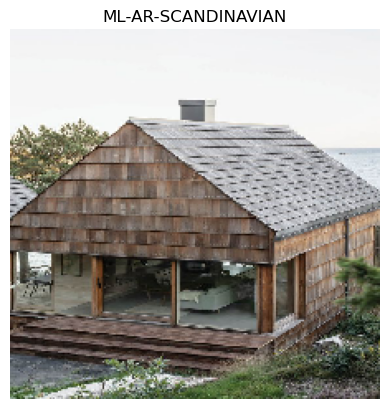

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
Top 3 Predictions:
ML-AR-THAI : 63.70%
ML-AR-SCANDINAVIAN : 17.63%
ML-AR-TUDOR HOUSE : 8.45%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-THAI


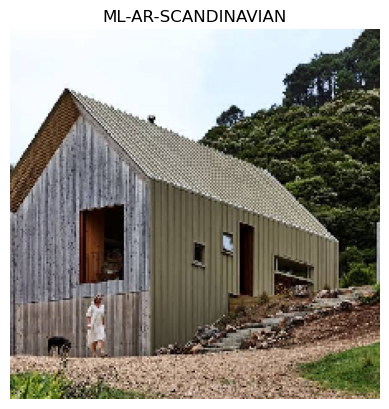

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 97.98%
ML-AR-THAI : 0.97%
ML-AR-Oriental : 0.48%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


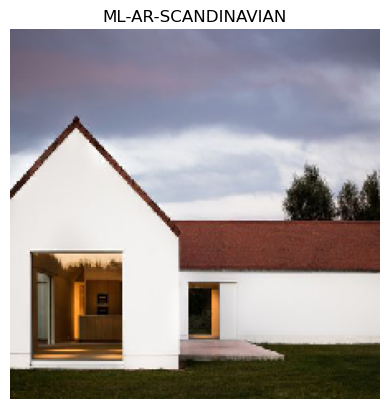

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 83.61%
ML-AR-TRANSITIONAL : 10.15%
ML-AR-Modern Minimal : 3.24%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


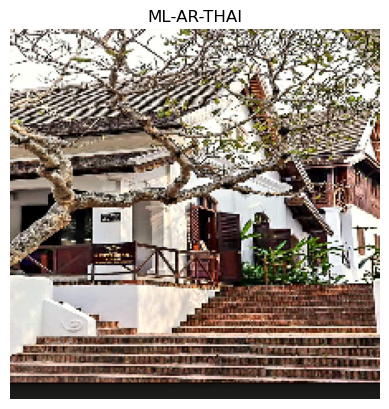

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
Top 3 Predictions:
ML-AR-THAI : 67.22%
ML-AR-TUDOR HOUSE : 27.10%
ML-AR-VICTORIAN : 4.15%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


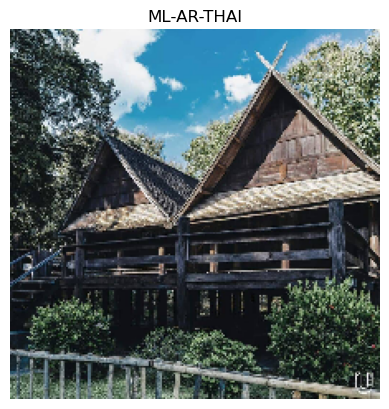

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
Top 3 Predictions:
ML-AR-THAI : 92.60%
ML-AR-TUDOR HOUSE : 5.78%
ML-AR-Oriental : 1.45%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


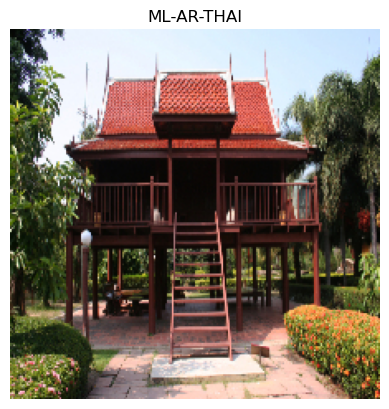

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
Top 3 Predictions:
ML-AR-THAI : 99.91%
ML-AR-TUDOR HOUSE : 0.04%
ML-AR-Oriental : 0.04%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


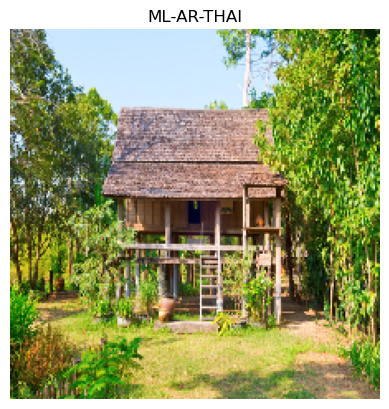

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
Top 3 Predictions:
ML-AR-THAI : 98.98%
ML-AR-TUDOR HOUSE : 0.46%
ML-AR-Oriental : 0.42%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


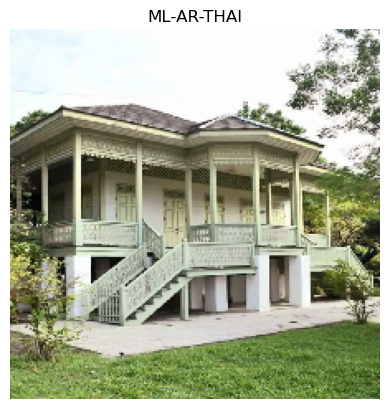

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 23.76%
ML-AR-Oriental : 15.44%
ML-AR-TRANSITIONAL : 13.84%
Actual Class: ML-AR-THAI
Prediction: ML-AR-Modern Minimal


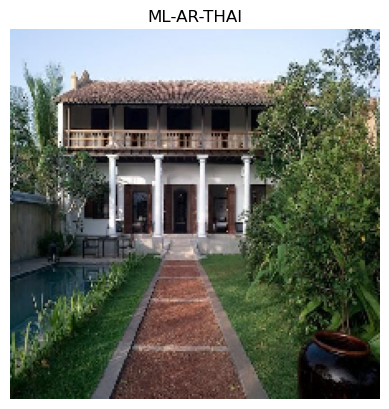

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
Top 3 Predictions:
ML-AR-Oriental : 30.75%
ML-AR-THAI : 28.41%
ML-AR-MEDITERRANEAN : 10.44%
Actual Class: ML-AR-THAI
Prediction: ML-AR-Oriental


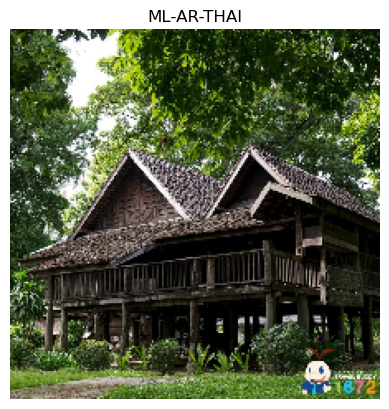

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
Top 3 Predictions:
ML-AR-THAI : 91.80%
ML-AR-TUDOR HOUSE : 7.22%
ML-AR-Oriental : 0.85%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


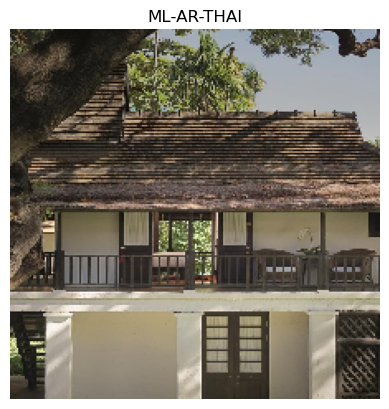

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
Top 3 Predictions:
ML-AR-THAI : 37.99%
ML-AR-Oriental : 33.04%
ML-AR-SCANDINAVIAN : 21.28%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


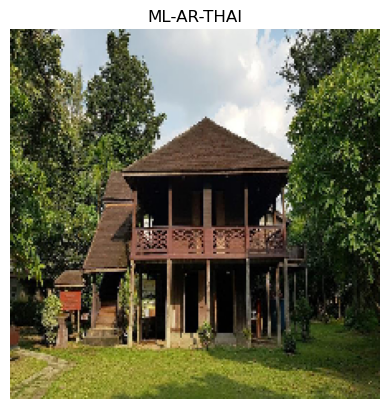

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
Top 3 Predictions:
ML-AR-THAI : 98.07%
ML-AR-Oriental : 0.99%
ML-AR-TUDOR HOUSE : 0.73%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


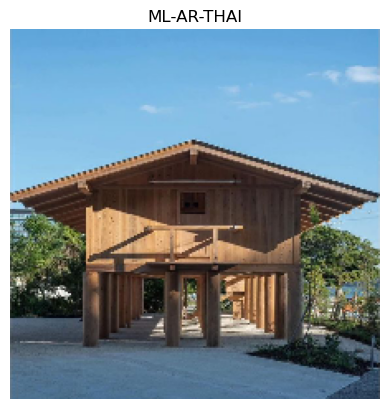

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Top 3 Predictions:
ML-AR-Oriental : 23.21%
ML-AR-MID CENTURY : 22.34%
ML-AR-THAI : 18.20%
Actual Class: ML-AR-THAI
Prediction: ML-AR-Oriental


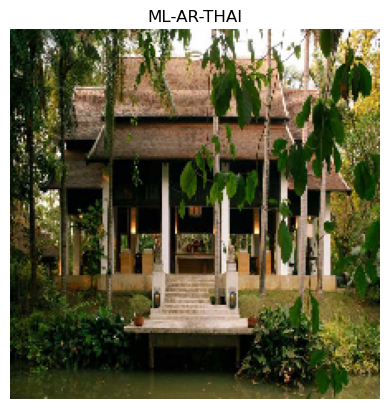

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
Top 3 Predictions:
ML-AR-THAI : 91.30%
ML-AR-Oriental : 7.51%
ML-AR-MID CENTURY : 0.24%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


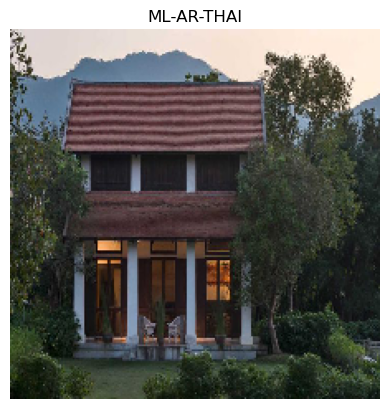

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
Top 3 Predictions:
ML-AR-THAI : 76.36%
ML-AR-Oriental : 9.93%
ML-AR-MEDITERRANEAN : 2.86%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


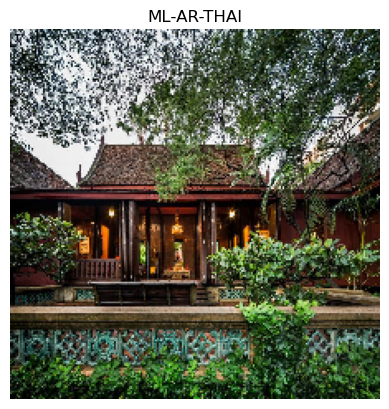

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 78.74%
ML-AR-THAI : 13.96%
ML-AR-Oriental : 3.45%
Actual Class: ML-AR-THAI
Prediction: ML-AR-MID CENTURY


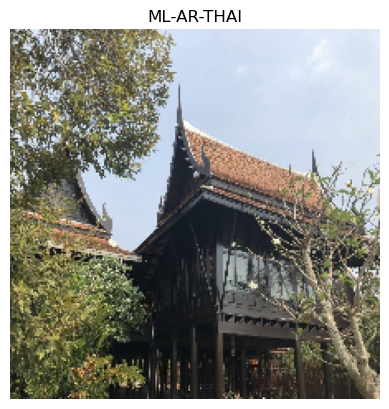

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
Top 3 Predictions:
ML-AR-THAI : 99.07%
ML-AR-Oriental : 0.60%
ML-AR-TUDOR HOUSE : 0.27%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


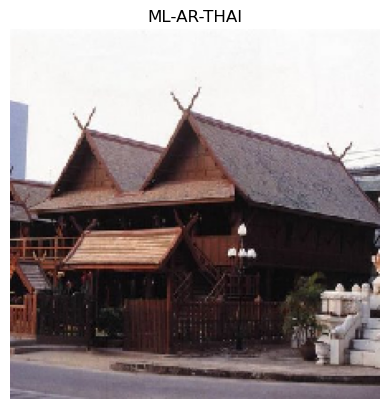

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
Top 3 Predictions:
ML-AR-THAI : 99.75%
ML-AR-Oriental : 0.13%
ML-AR-TUDOR HOUSE : 0.10%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


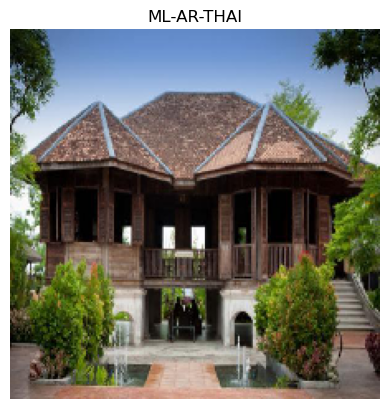

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
Top 3 Predictions:
ML-AR-THAI : 70.76%
ML-AR-TUDOR HOUSE : 13.15%
ML-AR-Oriental : 6.40%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


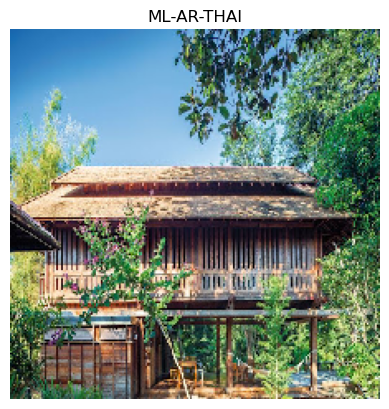

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
Top 3 Predictions:
ML-AR-THAI : 98.38%
ML-AR-Oriental : 0.78%
ML-AR-MID CENTURY : 0.46%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


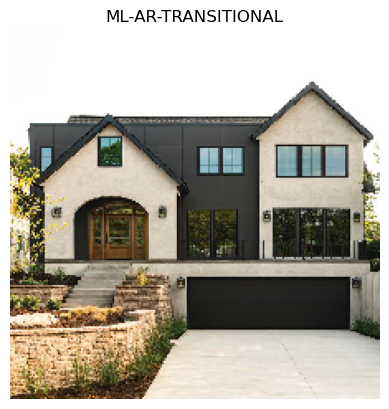

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 57.09%
ML-AR-TUDOR HOUSE : 11.72%
ML-AR-SCANDINAVIAN : 7.29%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


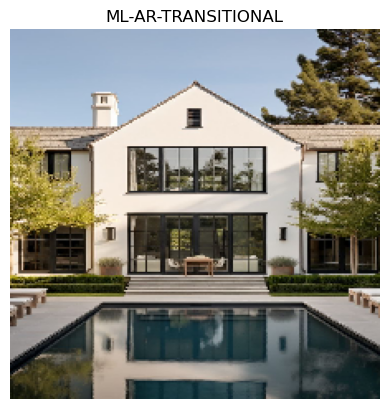

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 35.02%
ML-AR-Modern Minimal : 17.92%
ML-AR-Oriental : 16.40%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


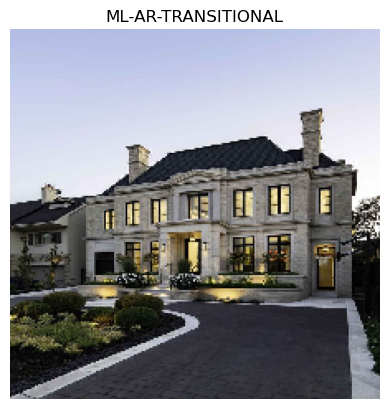

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
Top 3 Predictions:
ML-AR-Classic : 59.12%
ML-AR-VICTORIAN : 26.47%
ML-AR-TRANSITIONAL : 4.25%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-Classic


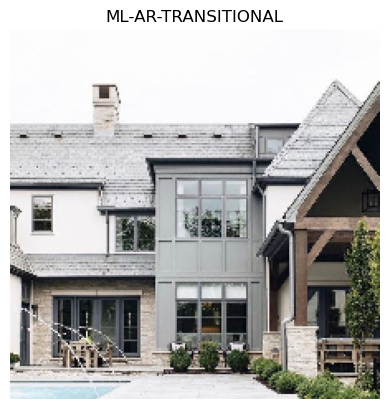

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 69.31%
ML-AR-VICTORIAN : 9.28%
ML-AR-Classic : 5.62%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


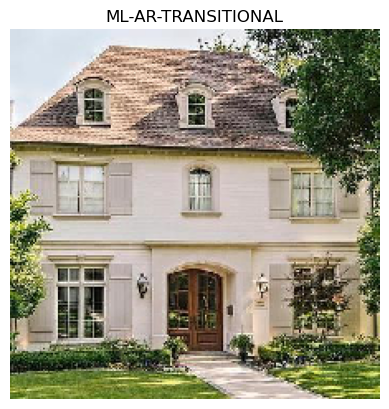

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 51.25%
ML-AR-TRANSITIONAL : 13.10%
ML-AR-Classic : 11.91%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-VICTORIAN


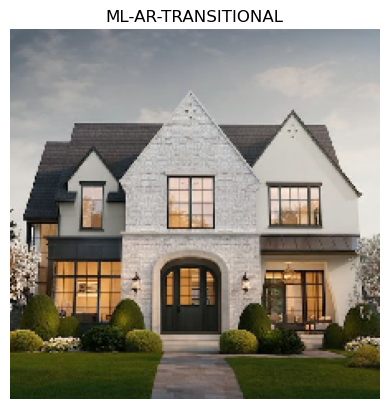

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 82.40%
ML-AR-TUDOR HOUSE : 16.06%
ML-AR-VICTORIAN : 0.51%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


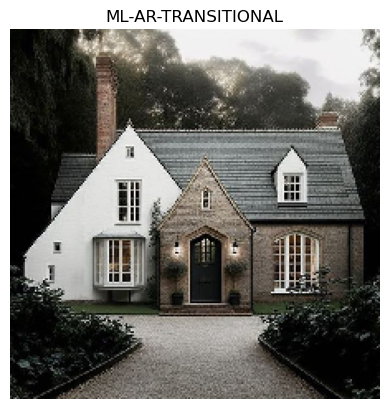

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 50.14%
ML-AR-TRANSITIONAL : 46.47%
ML-AR-SCANDINAVIAN : 1.28%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TUDOR HOUSE


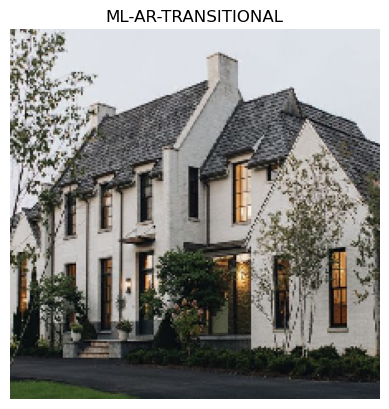

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 57.34%
ML-AR-TUDOR HOUSE : 35.24%
ML-AR-THAI : 3.12%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


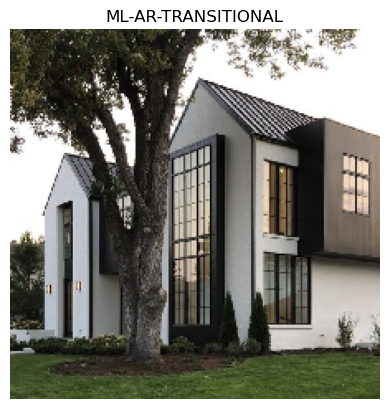

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 42.29%
ML-AR-SCANDINAVIAN : 30.46%
ML-AR-Modern Minimal : 17.93%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


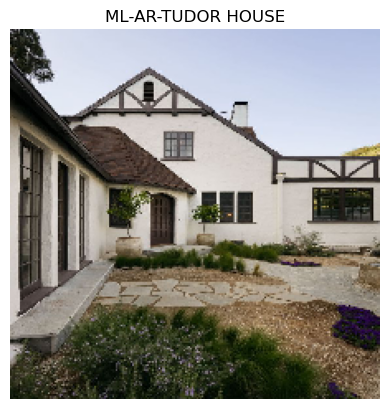

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 134ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 43.67%
ML-AR-TRANSITIONAL : 42.28%
ML-AR-SCANDINAVIAN : 7.22%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


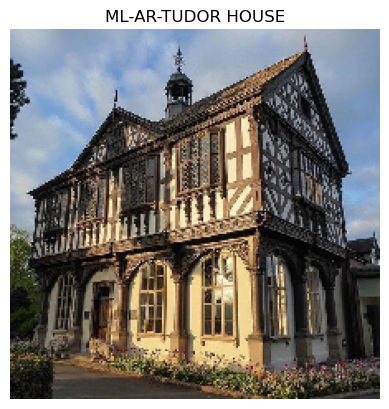

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 196ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 90.93%
ML-AR-VICTORIAN : 7.99%
ML-AR-Classic : 0.60%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


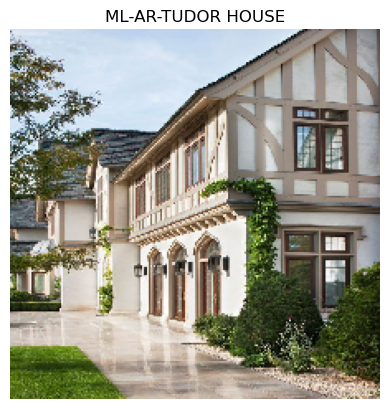

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 54.15%
ML-AR-MEDITERRANEAN : 23.16%
ML-AR-Classic : 8.36%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-COLONIAL


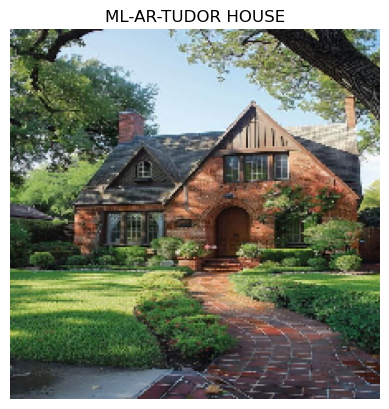

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 146ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 99.27%
ML-AR-THAI : 0.32%
ML-AR-TRANSITIONAL : 0.12%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


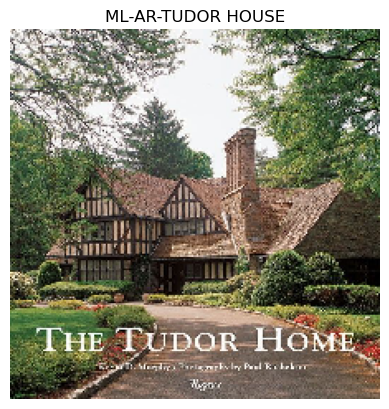

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 99.62%
ML-AR-THAI : 0.28%
ML-AR-VICTORIAN : 0.05%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


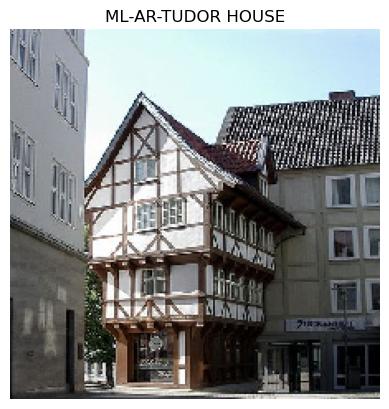

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 94.94%
ML-AR-Chicago School : 2.00%
ML-AR-VICTORIAN : 1.83%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


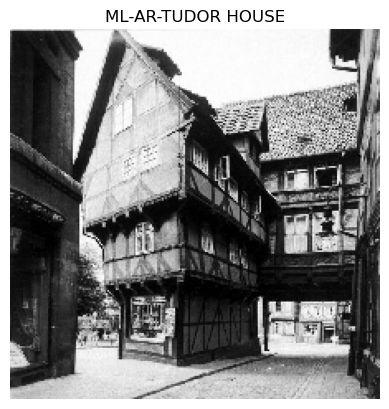

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 186ms/step
Top 3 Predictions:
ML-AR-THAI : 72.85%
ML-AR-TUDOR HOUSE : 6.27%
ML-AR-COLONIAL : 4.33%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-THAI


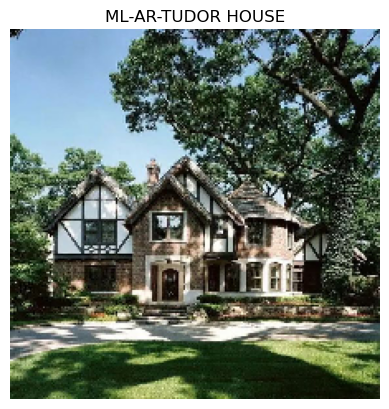

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 97.97%
ML-AR-TRANSITIONAL : 1.48%
ML-AR-VICTORIAN : 0.31%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


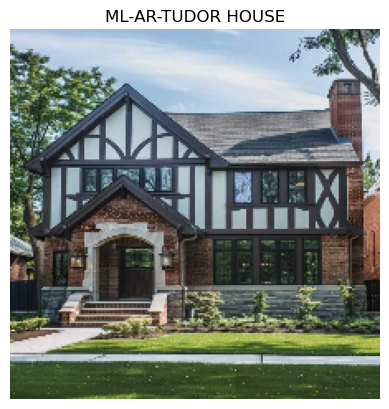

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 98.07%
ML-AR-TRANSITIONAL : 0.86%
ML-AR-VICTORIAN : 0.49%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


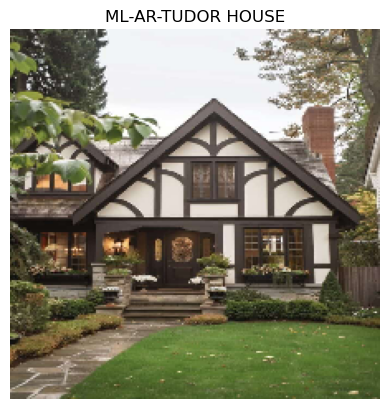

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 90.11%
ML-AR-TRANSITIONAL : 2.64%
ML-AR-THAI : 2.36%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


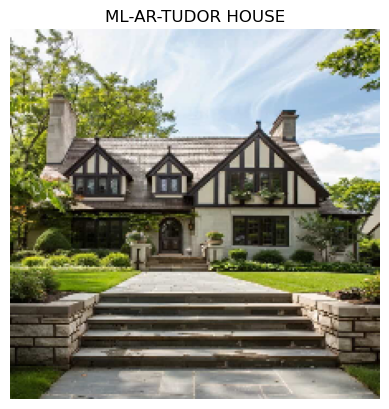

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 97.84%
ML-AR-THAI : 0.90%
ML-AR-TRANSITIONAL : 0.61%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


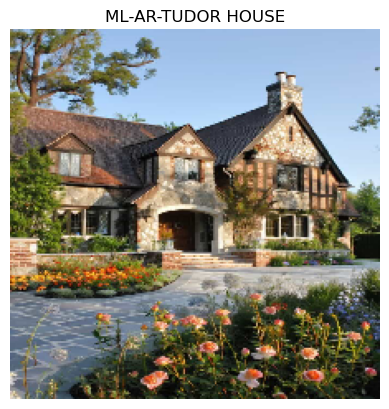

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 59.87%
ML-AR-THAI : 35.40%
ML-AR-Oriental : 1.67%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


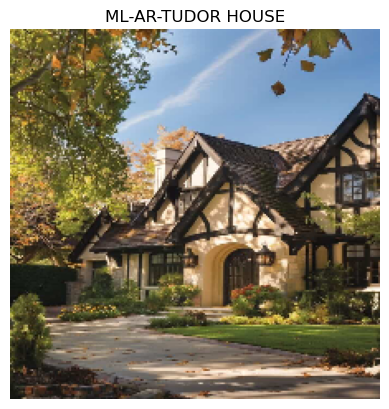

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 91.30%
ML-AR-THAI : 8.36%
ML-AR-Oriental : 0.12%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


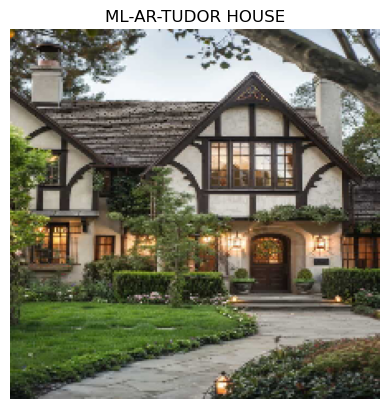

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 55.90%
ML-AR-TRANSITIONAL : 27.40%
ML-AR-MEDITERRANEAN : 3.51%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


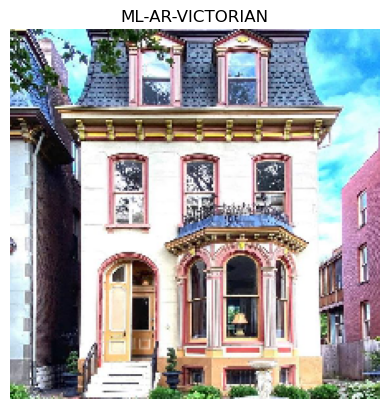

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 83.67%
ML-AR-VICTORIAN : 10.94%
ML-AR-MEDITERRANEAN : 4.73%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-COLONIAL


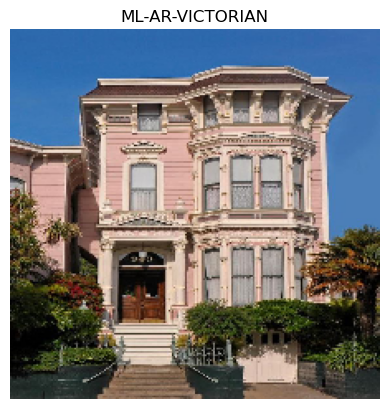

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 150ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 71.80%
ML-AR-COLONIAL : 18.35%
ML-AR-Classic : 7.77%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


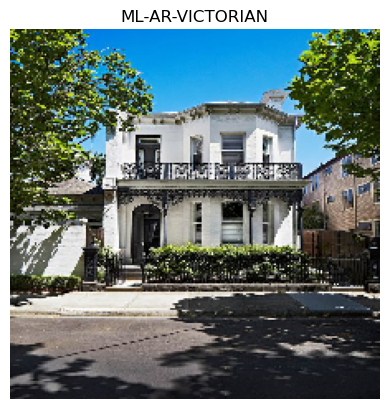

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 48.71%
ML-AR-Classic : 31.48%
ML-AR-COLONIAL : 7.28%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


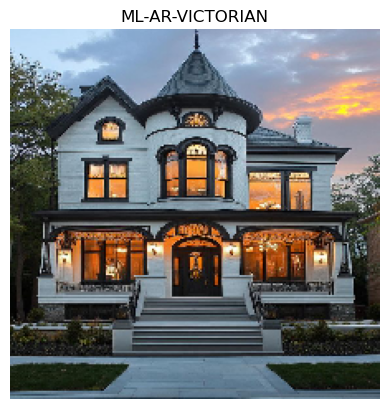

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 72.78%
ML-AR-TUDOR HOUSE : 14.82%
ML-AR-TRANSITIONAL : 3.70%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


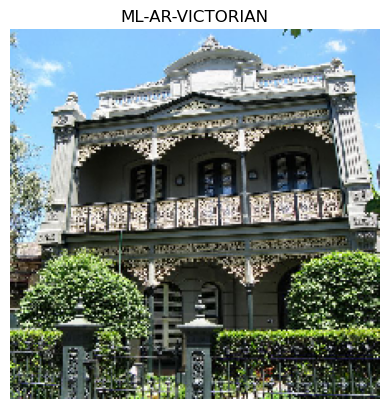

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 87.03%
ML-AR-COLONIAL : 10.69%
ML-AR-Classic : 0.65%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


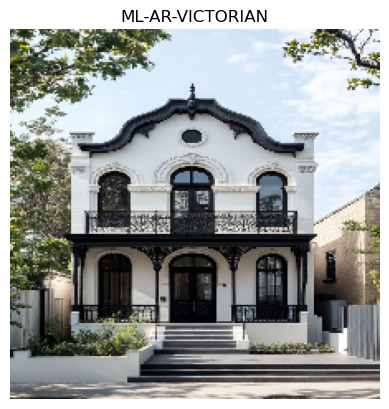

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 65.38%
ML-AR-Classic : 18.55%
ML-AR-COLONIAL : 6.49%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


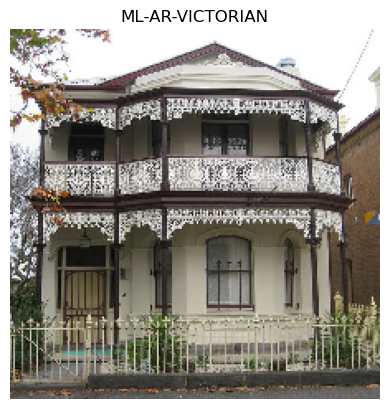

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 148ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 55.66%
ML-AR-COLONIAL : 16.74%
ML-AR-THAI : 9.49%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


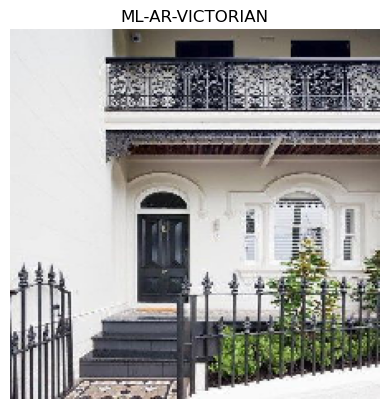

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 38.33%
ML-AR-COLONIAL : 36.00%
ML-AR-Classic : 6.06%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


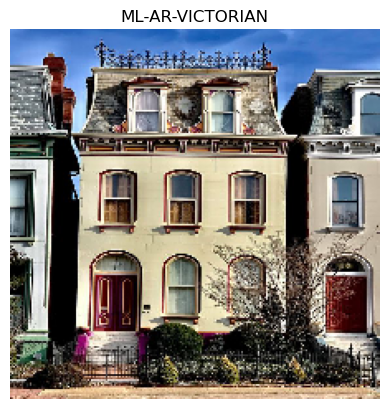

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 85.78%
ML-AR-COLONIAL : 12.23%
ML-AR-Classic : 1.23%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


In [42]:
import glob

import glob

# Get all images in the subfolders of "test"
# mylist = [f for f in glob.glob(r'D:\Real Estate\House_Style_Project\House_style_ML\Train_Test_Folder\test\**\*', recursive=True) if not os.path.isdir(f)]
mylist = [
    f for f in glob.glob(os.path.join(os.path.join(os.getcwd(), 'Train_Test_Folder', 'test'), '**', '*'), recursive=True)
    if not os.path.isdir(f)
]
# # Print the list of image paths
# print(mylist)

for i in mylist:
    predict(i)
    # print(os.path.basename(i), end = '/')